In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

import PDI.filtros.frecuencia as freq
import PDI.filtros.espacial as espc
import PDI.utils.utils as utils
import PDI.color.color as color
import PDI.histograma.histo as histo

In [2]:
import glob

filenames = [img for img in glob.glob("./Imagenes/*.jpg")]

In [3]:
images = [cv.imread(img) for img in filenames]

In [4]:
len(images)

8

In [5]:
for i,img in enumerate(images):
    images[i] = cv.cvtColor(img, cv.COLOR_BGR2RGB)

Todas las imágenes de prueba

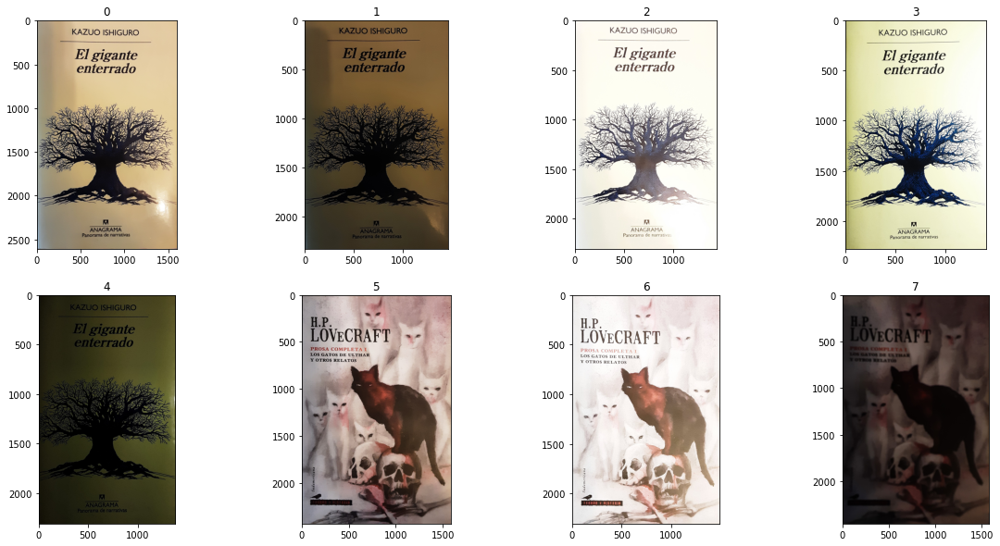

In [6]:
utils.plot(images, figsize=(20,10), patron=(2,4), titulos=['0','1','2','3','4','5','6','7'])

Transformo todas las imágenes a HSV para poder trabajr directamente en el canal de *value*

In [7]:
images_hsv = []
for img in images:
    images_hsv.append(color.RGB2HSV(img))

Hago pruebas sobr la imagen `4` que presenta mayores problemas

Veo los canales por HSV por separado

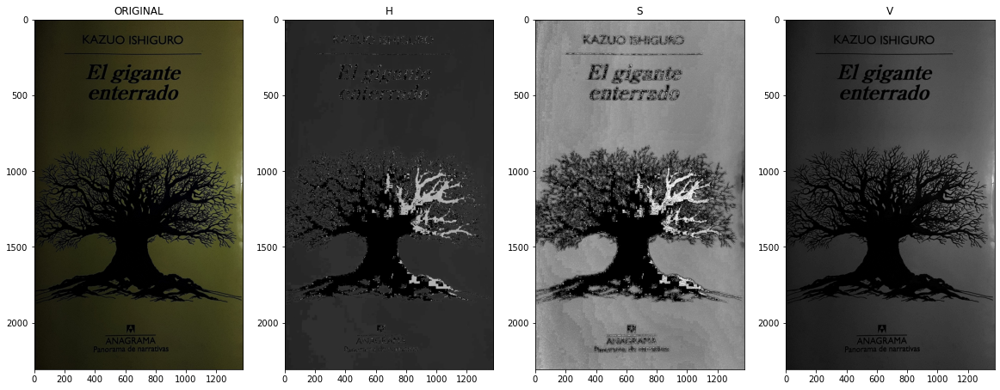

In [8]:
color.plot_color_channels(images[4], space='hsv')

In [9]:
channels_hsv = cv.split(images_hsv[4])

Analizando sólo el canal **V**, veo el histograma *original*, su ecualización *global* y *local (Clahe)*  
La imagen contiene altos niveles de grises y posee un bajo contraste. Con la ecualización global se consigue una imagen con una mejor distribución de los grises. La ecualización local logra también conseguir un mejor contraste de niveles de grises aumentando el rango dinámico, sin embargo, se consigue un efecto de *quemado* en la imagen que podría complicar inecesariamente el procesamiento posterior de la imsma.  
La imagen obtenida por ecualización global ya se encuentra un estado mucho mejor que la imagen original. Se prosigue aplicando, sobre esta imagen, una simple transformación lineal por tramos, para buscar llevar el rango dinámico de grises a valores más altos.

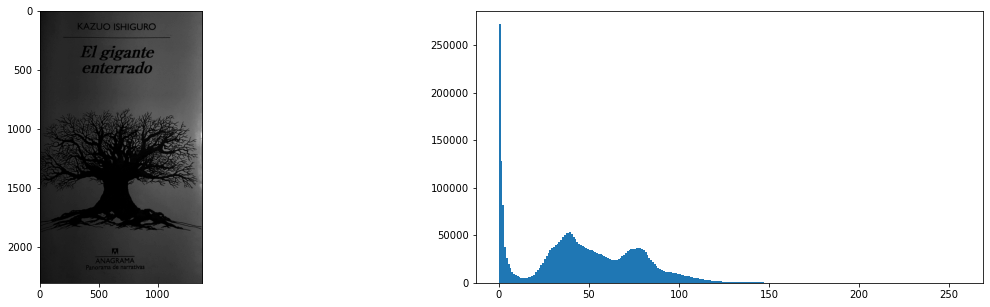

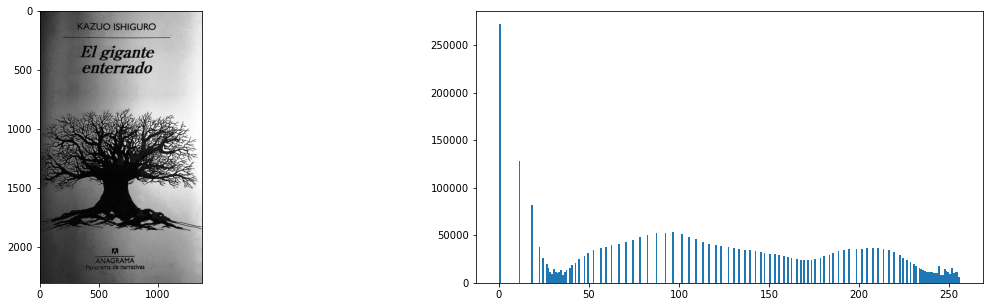

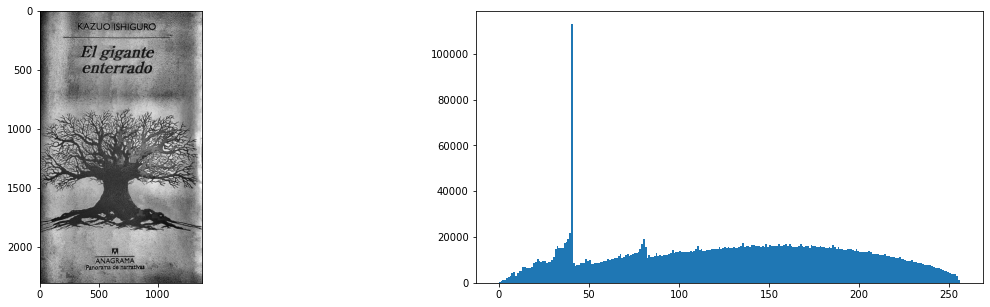

In [10]:
histo.plot_histo([channels_hsv[2]])
histo.plot_histo([channels_hsv[2]], eq='global')
histo.plot_histo([channels_hsv[2]], eq='local')

Creo una transformación por tramos y la muestro

In [11]:
t_tramos = utils.t_lut_tramos(([50, 2, 20], [1,255]))

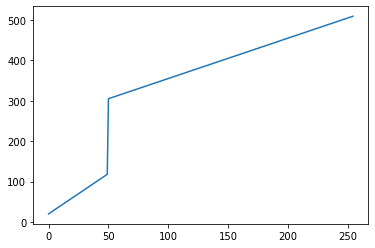

In [12]:
plt.plot(np.arange(255), t_tramos[np.arange(255)])

Aplico la transformación sobre el canal de **value**.  
Primero, se hará la prueba de realizar las ecualizaciones previas sobre el canal *V* **sin ecualización**, para luego ver las diferencias del orden de procesamiento.

In [13]:
channel_vlut = t_tramos[channels_hsv[2]].astype('uint8')

Como se puede ver, al aplicar la ecualización global luego de aplciar la transformación lineal, el efecto que esta última aporta se "pierde" en gran parte por el propio proceso de ecualización, y resulta en una imagen con peores resultados que la imagen obtenida previamente a partir de la ecualización.  
En el caso de la ecualización local, el resultado es prácticamente el mismo, pero sigue siendo no muy deseable.

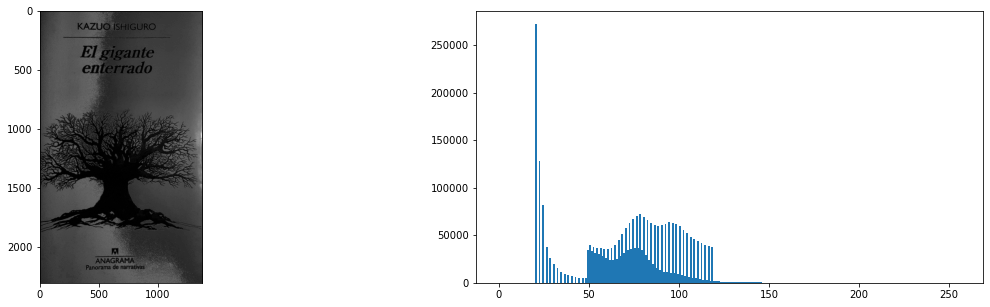

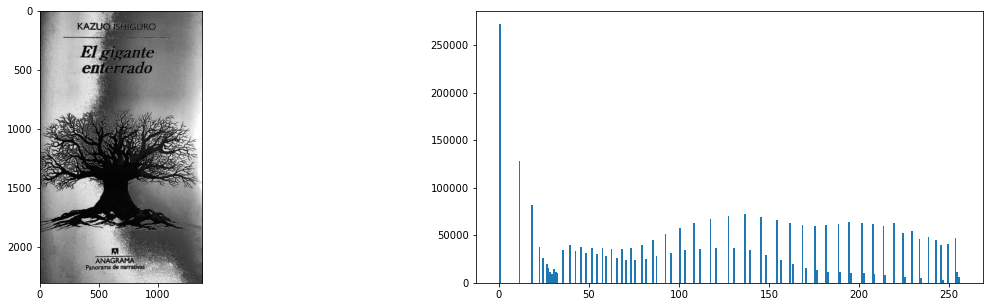

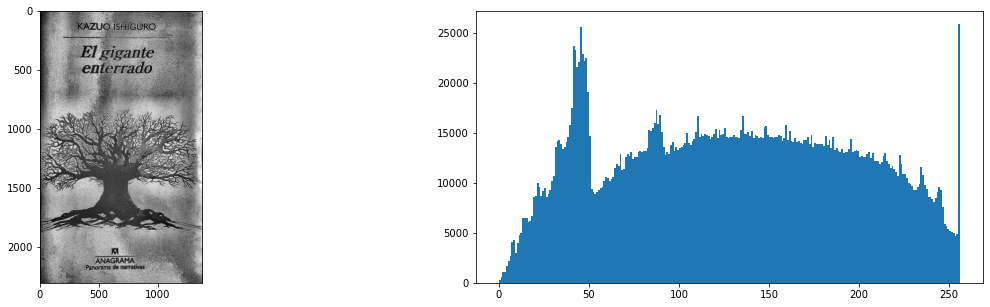

In [14]:
histo.plot_histo([channel_vlut])
histo.plot_histo([channel_vlut], eq='global')
histo.plot_histo([channel_vlut], eq='local')

Ahora se realiza el mismo análisis pero aplicando la transformación sobre las ecualizaciones.  
Para el caso de la ecualizacion global, el resultado de aplicar primero la ecualización y luego la trasnformación lineal da mejores resultados que realizar el proceso inverso.  
Para el caso de la ecualización local es un poco más complicado. Realizar ecualización y luego trasnformación, llevó a una imagen con un menor rango dinámico y mayor presencia de grises de valores altos. A diferencia del proceso inverso que generó una imagen con alto rango dinámico.

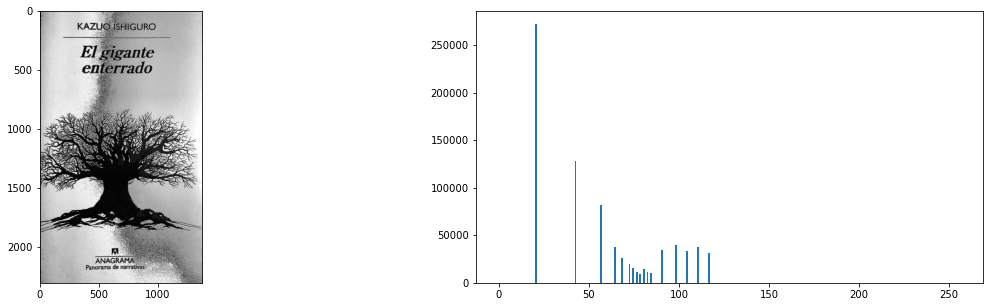

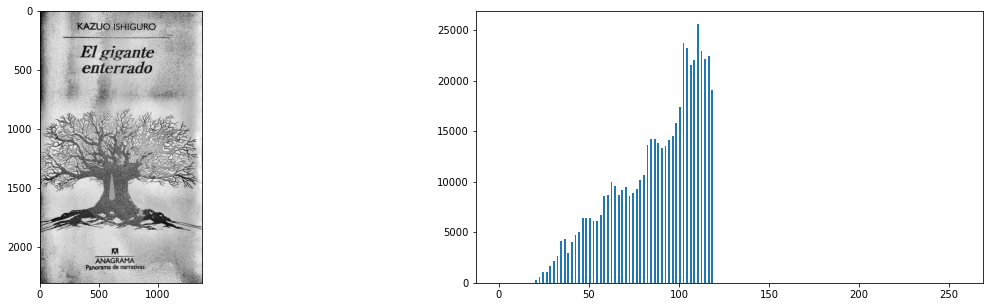

In [15]:
histo.plot_histo([t_tramos[histo.eq_global(channel_vlut)]])
histo.plot_histo([t_tramos[histo.eq_local(channel_vlut)]])

Se ven los resultados obtenidos en los distintos casos estudiados.

### Sólo LUT.

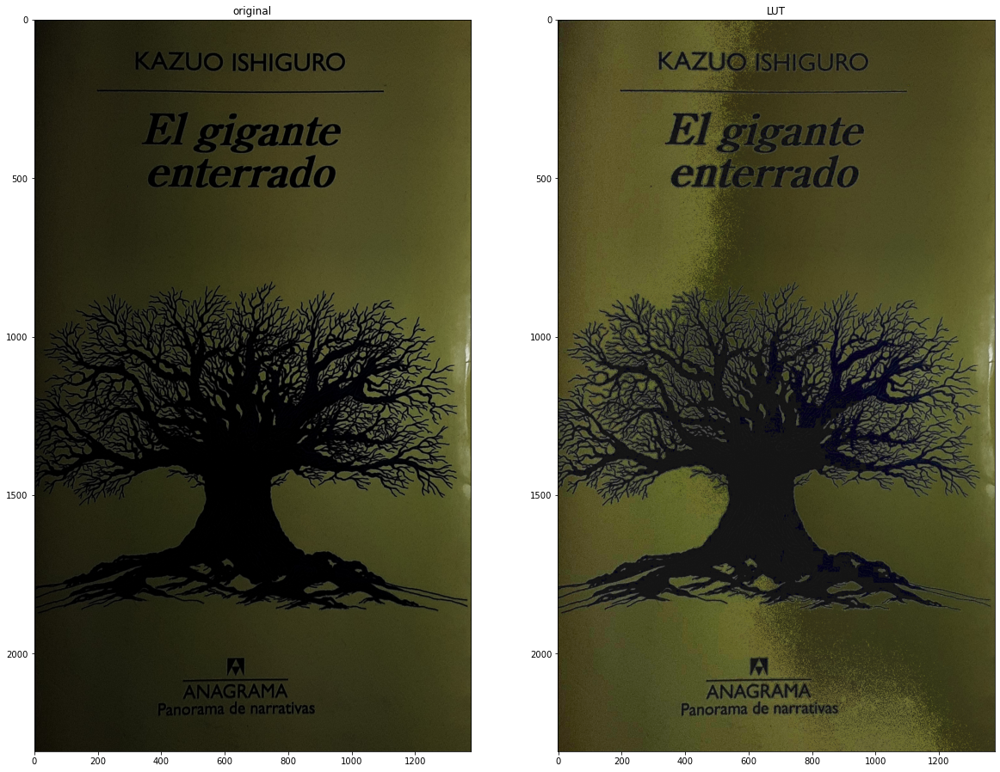

In [16]:
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], channel_vlut]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'LUT'])

### Sólo ecualización global.

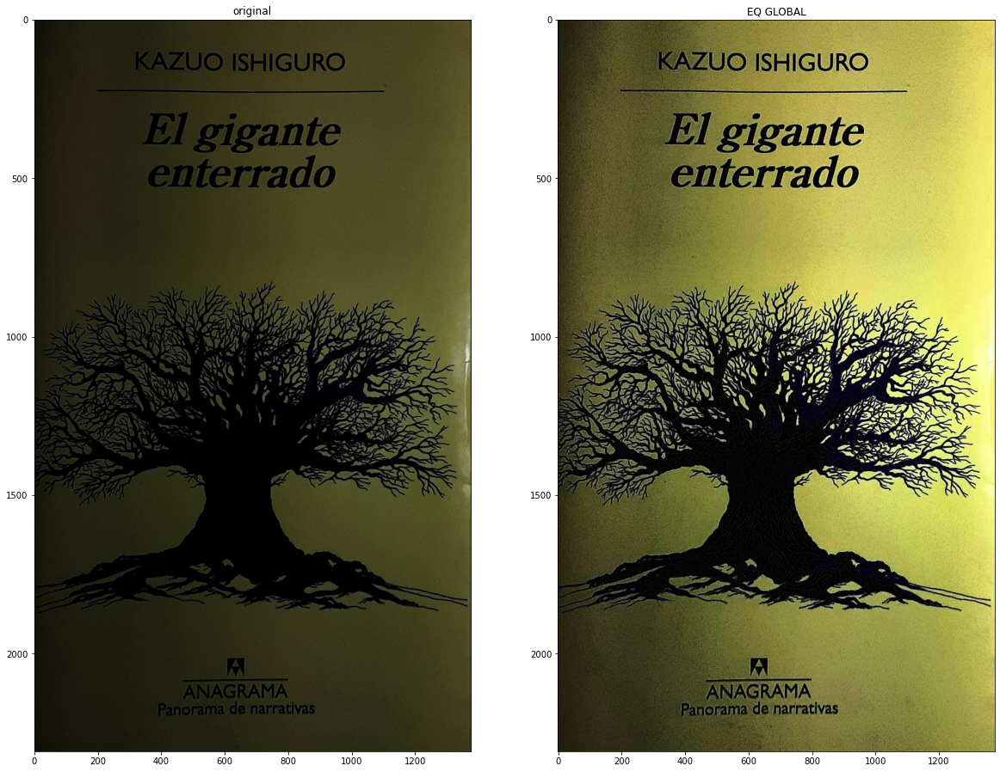

In [17]:
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], histo.eq_global(channels_hsv[2].astype('uint8'))]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'EQ GLOBAL'])

### Sólo ecualización local.

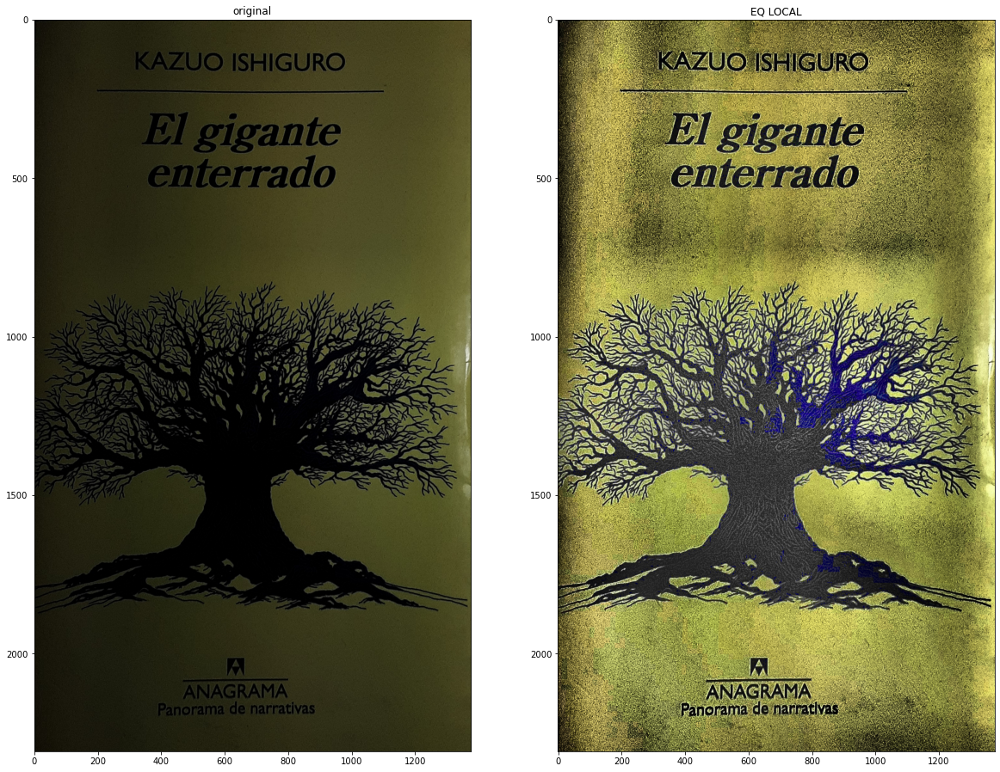

In [18]:
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], histo.eq_local(channels_hsv[2].astype('uint8'))]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'EQ LOCAL'])

### EQ global y luego LUT.

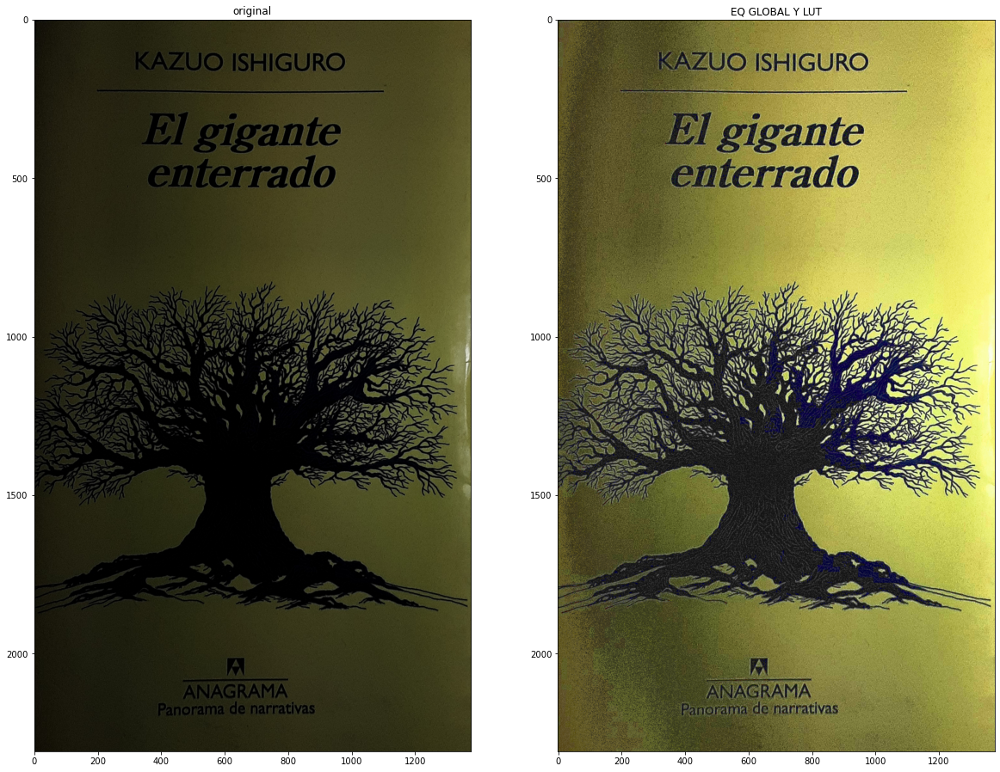

In [19]:
channel_v_globalylut = t_tramos[histo.eq_global(channels_hsv[2])].astype('uint8')
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], channel_v_globalylut]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'EQ GLOBAL Y LUT'])

### EQ local y luego LUT

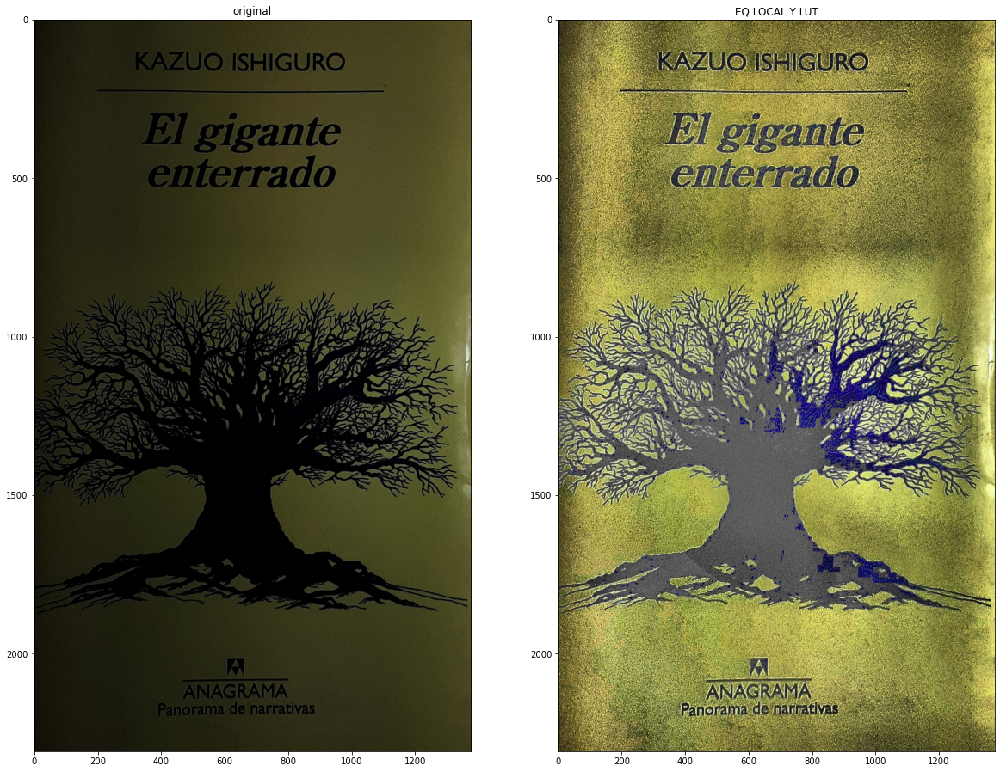

In [20]:
channel_v_localylut = t_tramos[histo.eq_local(channels_hsv[2])].astype('uint8')
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], channel_v_localylut]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'EQ LOCAL Y LUT'])

### LUT y luego EQ global.

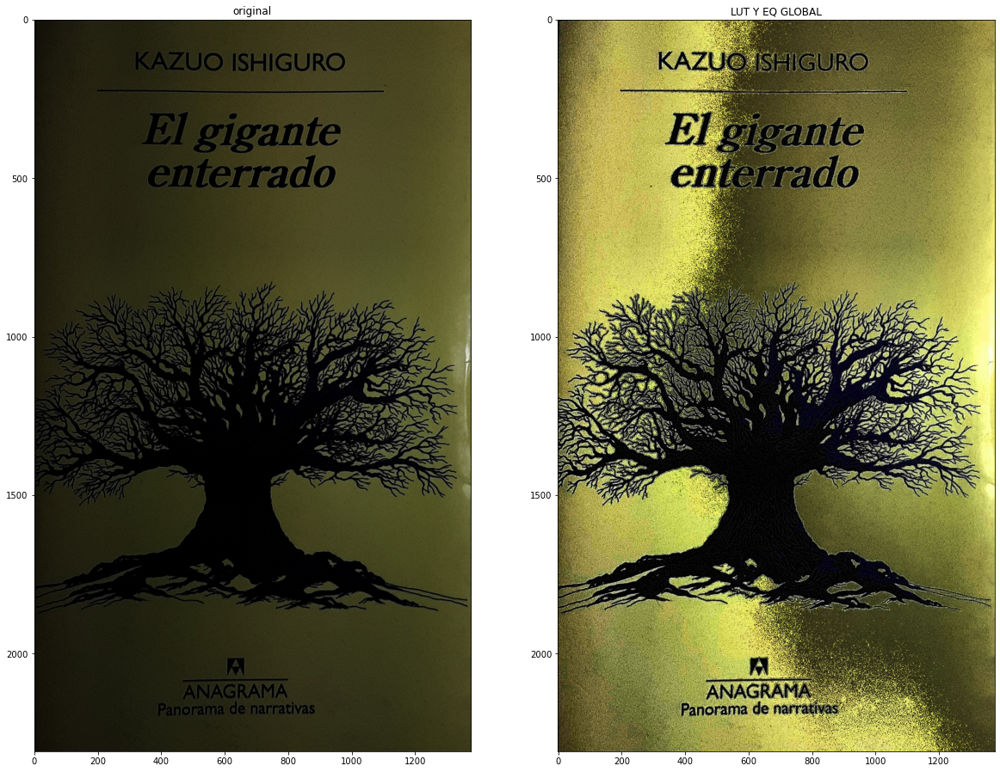

In [21]:
channel_v_lutyglobal = histo.eq_global(t_tramos[channels_hsv[2]].astype('uint8'))
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], channel_v_lutyglobal]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'LUT Y EQ GLOBAL'])

### LUT y luego EQ local.

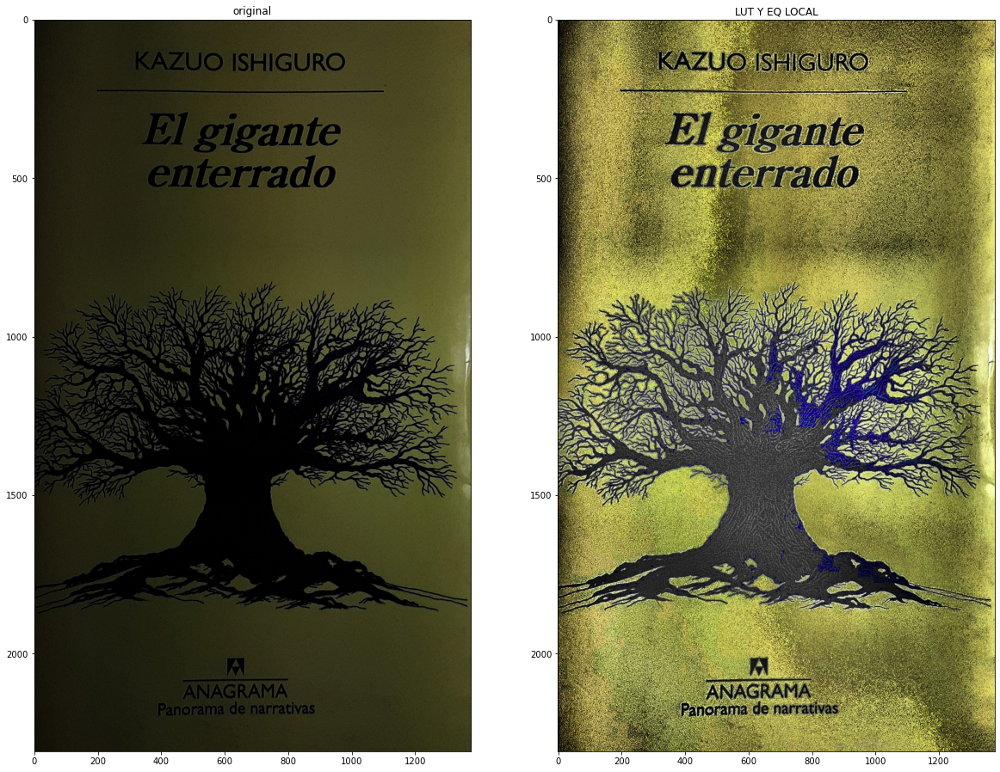

In [22]:
channel_v_lutylocal = histo.eq_local(t_tramos[channels_hsv[2]].astype('uint8'))
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], channel_v_lutylocal]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'LUT Y EQ LOCAL'])

Se realiza otra prueba, pero en este caso realizando un filtrado homomórfico al canal **value**, para tener un mayor control en el rango dinámico de las frecuencias altas y bajas. Este método se combinará también con una ecualizaión tanto global como local.

In [101]:
def aplicar_homomorfico(img, low, high, fc, n):
    """
    Aplica un filtro homomórfico a la imagen

    @param low: imagen de salida mínimo
    @param high: imagen de salida máximo
    @param fc: frecuencia de corte en [0, 255]
    @param n: orden del filtro 
    @retun (filtro aplicado, imagen filtrada)
    """

    assert n>=0, 'El orden del filtro no puede ser negativo'

    if(fc<0 or fc >255):
        warnings.warn('\'fc\' fuera de rango. Se hará clipping a [0, 255]')
        fc.clip(min=0, max=255)

    #LOG
    log_img = np.log(img.clip(0.00001))
    
    #DFT
    dft_img = np.fft.fft2(log_img)
    
    #FILTRO H
    image_shape = img.shape
    filas = np.zeros((1, image_shape[1])); filas[0,:] = np.arange(image_shape[1])
    colum = np.zeros((image_shape[0], 1)); colum[:,0] = np.arange(image_shape[0])
    
    half_f = int(image_shape[1]/2)
    half_c = int(image_shape[0]/2)
    
    D = np.sqrt((filas-half_f)**2 + (colum-half_c)**2).clip(min=0.0001)
    H = low + ((high-low) / (1 + (fc/D)**(2*n)))
    
    h_img = np.multiply(H, dft_img)
    
    #IDFT
    idft_img = np.fft.ifft2(h_img)
    
    #EXP
    return (np.exp(np.real(idft_img)), H)

In [132]:
import ipywidgets as widgets
from ipywidgets import interact

### Filtro homomórfico

In [135]:
def update_hm(low,high,fc,n):
    channel_v_hm, filtro_hm = aplicar_homomorfico(channels_hsv[2].astype('uint8'), low, high, fc, n)
    
    plt.figure(figsize=(10,20))
    plt.subplot(2,2,1)
    plt.imshow(filtro_hm.astype('uint8'), cmap='gray')

    plt.subplot(2,2,2)
    H = low + ((high-low) / (1 + (fc/np.arange(255))**(2*n)))
    plt.plot(np.arange(255), H);

    plt.subplot(2,2,3)
    plt.imshow(channel_v_hm.astype('uint8'), cmap='gray')

interact(update_hm,
        low=widgets.IntSlider(min=-20, max=20, step=1, value=0),
        high=widgets.IntSlider(min=-20, max=20, step=1, value=3),
        fc=widgets.IntSlider(min=0, max=255, step=1, value=50),
        n=widgets.IntSlider(min=0, max=10, step=1, value=1)
    );

interactive(children=(IntSlider(value=10, description='low', max=20, min=-20), IntSlider(value=0, description=…

Se consigue relativamente un buen resultado con el filtrado homomórfico, principalamtne por la capacidad de modificar la iluminación y la reflectancia por separado. Con el filtro configurado anteriormente, se busca incrementar el brillo general de la imagen. Para esto, se amplifica el contenido de bajas frecuencias en el logaritmo del espectro en frecuencia.  
Sin embargo, el uso de este filtro, introduce una gran cantidad de ruido en la imagen.

Analizando el histograma y sus ecualizaciones

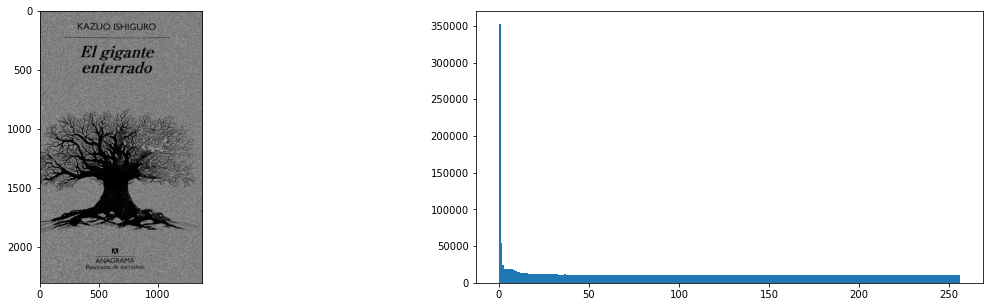

In [222]:
channel_v_hm, filtro_hm = aplicar_homomorfico(channels_hsv[2].astype('uint8'), 0, 3, 80, 3)
histo.plot_histo([channel_v_hm.astype('uint8')])

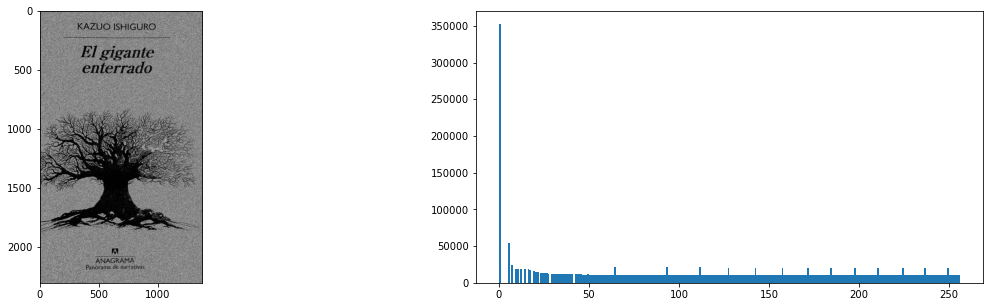

In [223]:
histo.plot_histo([channel_v_hm.astype('uint8')], eq='global')

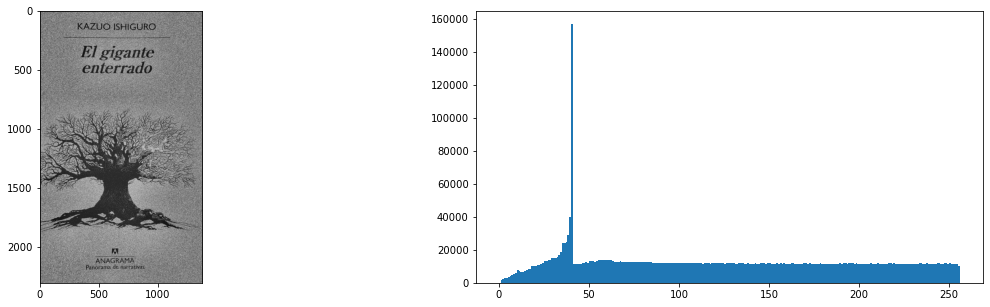

In [224]:
histo.plot_histo([channel_v_hm.astype('uint8')], eq='local')

Comparación del filtrado homomorifco sin ecualizar, y con ecualización local (Clahe).  
La ecualización logra recuperar ciertos detalles de la iamgen, pero el ruido sigue siendo un problema.

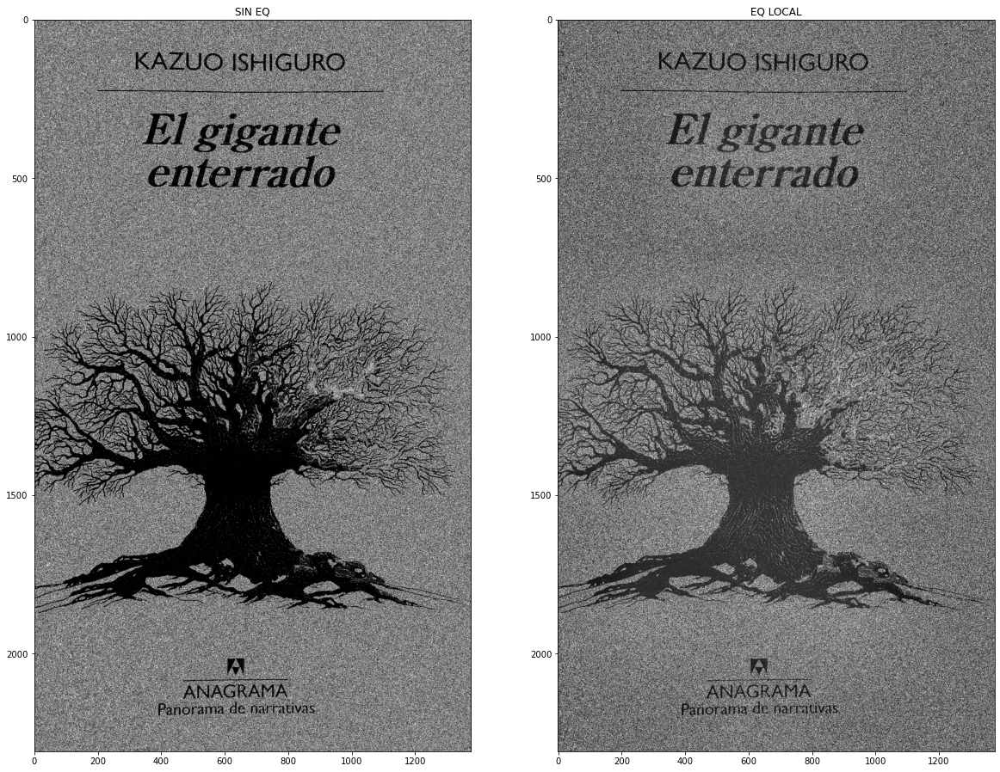

In [266]:
channel_v_eqlocal = (histo.eq_local(channel_v_hm.astype('uint8'))*1.2).astype('uint8')
utils.plot([channel_v_hm.astype('uint8'), channel_v_eqlocal], figsize=(20,20), patron=(1,2), titulos=['SIN EQ', 'EQ LOCAL'])

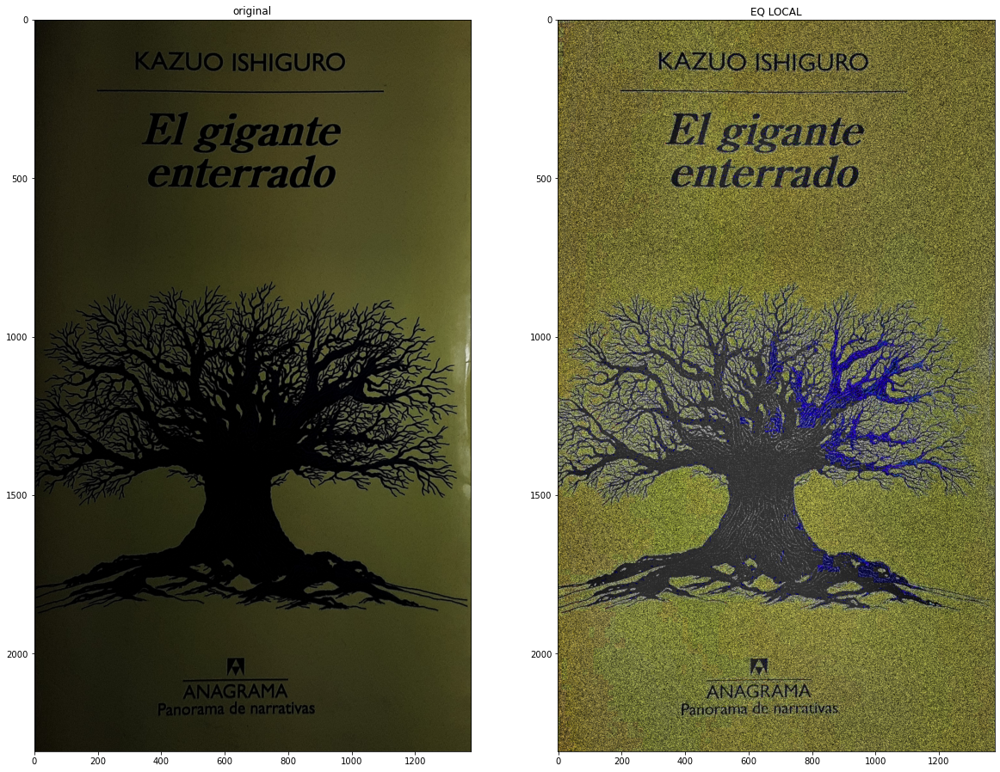

In [267]:
utils.plot([images[4], color.HSV2RGB(cv.merge([channels_hsv[0], channels_hsv[1], channel_v_eqlocal]))], figsize=(20,20), patron=(1,2), gray=False, titulos=['original', 'EQ LOCAL'])

Analzinado el histograma del espectro en frecuencia de la imagen ecualizada, se observa que el ruido posee características de un ruido Gaussiano o Rayleigh ***(VER PÁGINA 12 DE LAS DIAPO DE RESTAURACIÓN)***.  
Se podrían utlizar filtros de medias (media aritmética, media geometrica, media armonica), filtros de orden (punto medio, media alfa-recortado)

<Figure size 720x720 with 0 Axes>

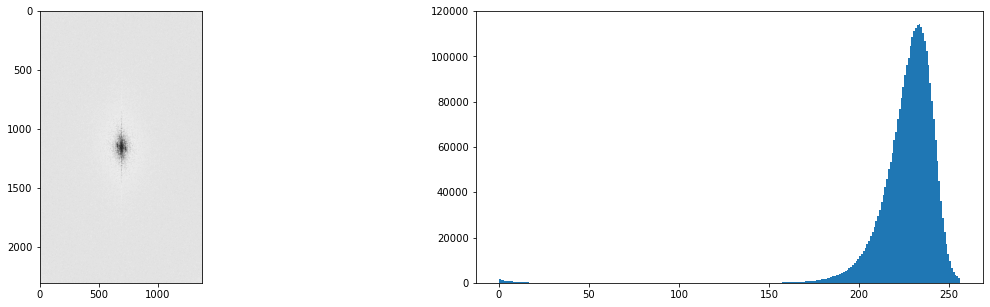

In [226]:
plt.figure(figsize=(10,10))
histo.plot_histo([freq.get_espectro(channel_v_eqlocal).astype('uint8')])

***REVISAR ESTOS FILTRO***

In [255]:
def filtro_media_armonica(img, m, n):
    pad_img = padding(img, pad=int((m-1)/2))
    f = np.zeros_like(img)
    
    for x in np.arange(img.shape[0]):
        for y in np.arange(img.shape[1]):
            if(x+m <= pad_img.shape[0] and y+n <= pad_img.shape[1]):
                suma = np.sum(1/pad_img[x:x+m, y:y+n])
                f[x,y] = (m*n)/(suma)
                
    return f

In [258]:
channel_v_mediaarm = filtro_media_armonica(channel_v_eqlocal, 5, 5).astype('uint8')

<ipython-input-255-154a76971ab1>:8: RuntimeWarning: divide by zero encountered in true_divide
  suma = np.sum(1/pad_img[x:x+m, y:y+n])


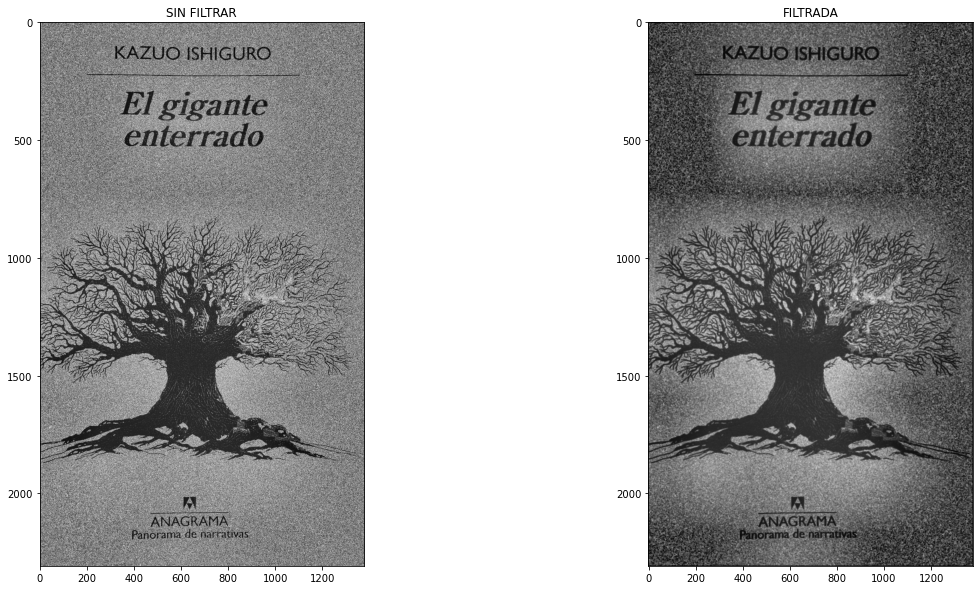

In [259]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.title('SIN FILTRAR')
plt.imshow(channel_v_eqlocal, cmap='gray')
plt.subplot(1,2,2)
plt.title('FILTRADA')
plt.imshow(channel_v_mediaarm, cmap='gray')

In [260]:
def filtro_punto_medio(img, m, n):
    pad_img = padding(img, pad=int((m-1)/2))
    f = np.zeros_like(img)
    
    for x in np.arange(img.shape[0]):
        for y in np.arange(img.shape[1]):
            if(x+m <= pad_img.shape[0] and y+n <= pad_img.shape[1]):
                f[x,y] = 0.5*(np.min(pad_img[x:x+m, y:y+n])+np.max(pad_img[x:x+m, y:y+n]))
                
    return f

In [261]:
channel_v_puntomedio = filtro_punto_medio(channel_v_eqlocal, 5, 5).astype('uint8')

<ipython-input-260-bdb214c414b9>:8: RuntimeWarning: overflow encountered in ubyte_scalars
  f[x,y] = 0.5*(np.min(pad_img[x:x+m, y:y+n])+np.max(pad_img[x:x+m, y:y+n]))


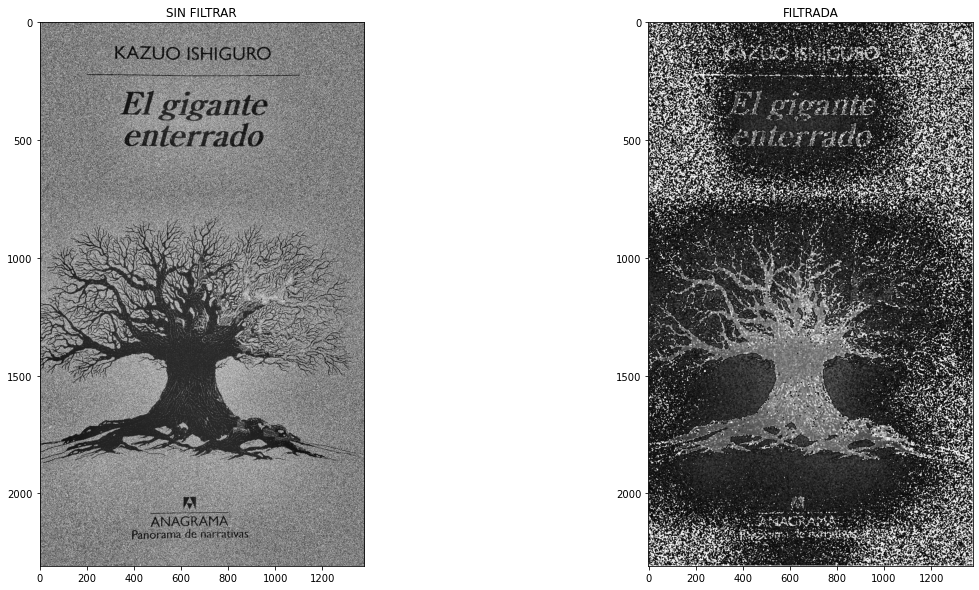

In [262]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.title('SIN FILTRAR')
plt.imshow(channel_v_eqlocal, cmap='gray')
plt.subplot(1,2,2)
plt.title('FILTRADA')
plt.imshow(channel_v_puntomedio, cmap='gray')

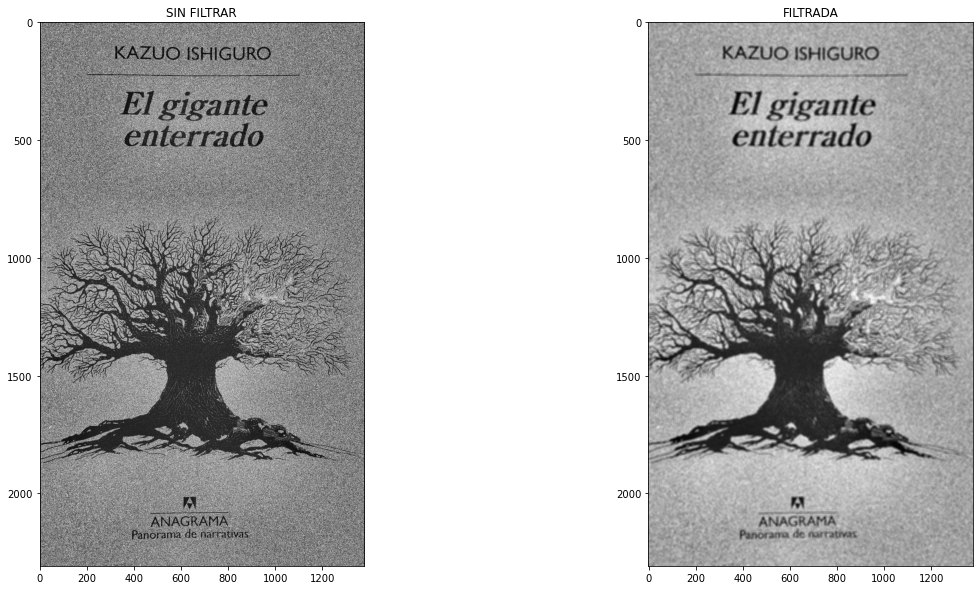

In [238]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.title('SIN FILTRAR')
plt.imshow(channel_v_eqlocal, cmap='gray')
plt.subplot(1,2,2)
plt.title('FILTRADA')
plt.imshow(cv.filter2D(channel_v_eqlocal, -1, espc.getkernel_prom(11)).astype('uint8'), cmap='gray')

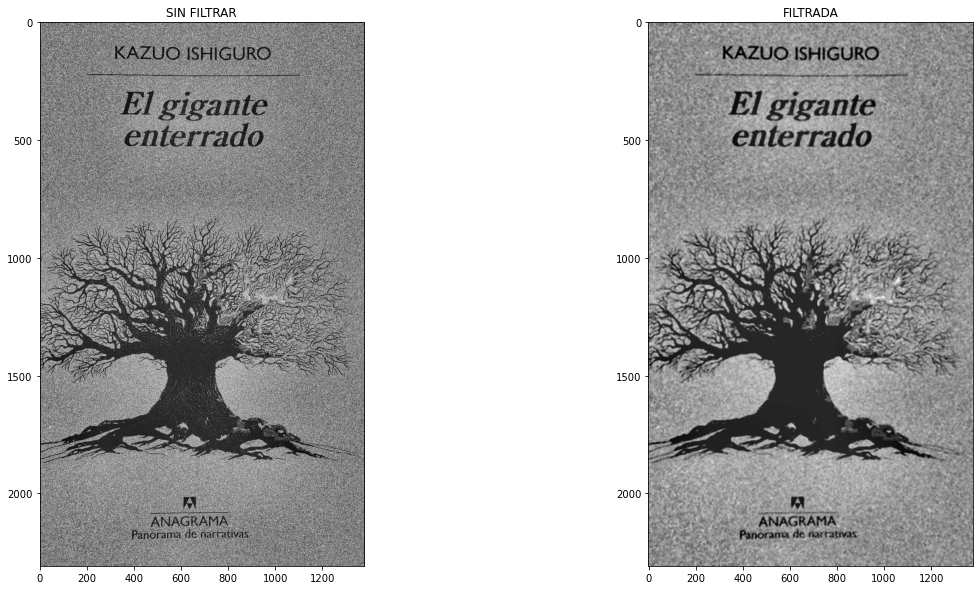

In [239]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.title('SIN FILTRAR')
plt.imshow(channel_v_eqlocal, cmap='gray')
plt.subplot(1,2,2)
plt.title('FILTRADA')
plt.imshow(cv.medianBlur(channel_v_eqlocal, 9), cmap='gray')